In [2]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms as T
import torchvision
import torch.nn.functional as F
from torch.autograd import Variable
from PIL import Image
import cv2
import albumentations as A
import time
import os
from tqdm.notebook import tqdm

/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.5' (you have '2.0.4'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [3]:
!pip install -q segmentation-models-pytorch
!pip install -q torchsummary
!pip install -q efficientnet_pytorch

In [4]:
import segmentation_models_pytorch as smp
from efficientnet_pytorch import EfficientNet

In [5]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

from segmentation_models_pytorch.losses import FocalLoss

Using device: cuda


In [11]:
BASE_PATH = '/kaggle/input/aerial-imagery-dataset-floodnet-challenge/FloodNet Challenge - Track 1'  
TRAIN_FLOODED_IMG_PATH = os.path.join(BASE_PATH, 'Train/Labeled/Flooded/image/')
TRAIN_FLOODED_MASK_PATH = os.path.join(BASE_PATH, 'Train/Labeled/Flooded/mask/')
TRAIN_NONFLOODED_IMG_PATH = os.path.join(BASE_PATH, 'Train/Labeled/Non-Flooded/image/')
TRAIN_NONFLOODED_MASK_PATH = os.path.join(BASE_PATH, 'Train/Labeled/Non-Flooded/mask/')
TRAIN_UNLABELED_IMG_PATH = os.path.join(BASE_PATH, 'Train/Unlabeled/image/')
VAL_IMG_PATH = os.path.join(BASE_PATH, 'Validation/image/')
TEST_IMG_PATH = os.path.join(BASE_PATH, 'Test/image/')

In [12]:
n_classes = 11  

In [13]:
# -------------- PREPROCESSING FUNCTIONS --------------

def preprocess_image(image, target_size=(512, 512)):
    """
    Preprocess image: crop last 1000 pixels along width and resize to target_size
    """
    # Check if image is already loaded or needs to be loaded from path
    if isinstance(image, str):
        img = cv2.imread(image)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    else:
        img = image.copy()
    
    # Get dimensions
    h, w = img.shape[:2]
    
    # Crop last 1000 pixels from width to make it more square
    # Original size: 3000x4000 -> Crop to 3000x3000
    if w > 3000:  # Only crop if the image is wider than expected
        img = img[:, :w-1000]
    
    # Resize to target size
    img = cv2.resize(img, target_size)
    
    return img

def preprocess_mask(mask, target_size=(512, 512)):
    """
    Preprocess mask: crop last 1000 pixels along width and resize to target_size
    """
    # Check if mask is already loaded or needs to be loaded from path
    if isinstance(mask, str):
        # Note: masks should be loaded as grayscale
        msk = cv2.imread(mask, cv2.IMREAD_GRAYSCALE)
    else:
        msk = mask.copy()
    
    # Get dimensions
    h, w = msk.shape[:2]
    
    # Crop last 1000 pixels from width to make it more square
    if w > 3000:  # Only crop if the mask is wider than expected
        msk = msk[:, :w-1000]
    
    # Resize to target size using nearest neighbor interpolation to preserve label values
    msk = cv2.resize(msk, target_size, interpolation=cv2.INTER_NEAREST)
    
    return msk

In [14]:
# -------------- DATASET CREATION --------------

def create_df():
    """
    Create a dataframe containing all labeled images from both flooded and non-flooded directories
    """
    data = []
    
    # Get flooded images
    for filename in os.listdir(TRAIN_FLOODED_IMG_PATH):
        if filename.endswith(('.jpg', '.png')):
            image_id = filename.split('.')[0]
            mask_filename = f"{image_id}_lab.png"  # Add _lab suffix for mask files
            
            if os.path.exists(os.path.join(TRAIN_FLOODED_MASK_PATH, mask_filename)):
                data.append({
                    'id': image_id,
                    'image_path': os.path.join(TRAIN_FLOODED_IMG_PATH, filename),
                    'mask_path': os.path.join(TRAIN_FLOODED_MASK_PATH, mask_filename),
                    'is_flooded': 1
                })
    
    # Get non-flooded images
    for filename in os.listdir(TRAIN_NONFLOODED_IMG_PATH):
        if filename.endswith(('.jpg', '.png')):
            image_id = filename.split('.')[0]
            mask_filename = f"{image_id}_lab.png"  # Add _lab suffix for mask files
            
            if os.path.exists(os.path.join(TRAIN_NONFLOODED_MASK_PATH, mask_filename)):
                data.append({
                    'id': image_id,
                    'image_path': os.path.join(TRAIN_NONFLOODED_IMG_PATH, filename),
                    'mask_path': os.path.join(TRAIN_NONFLOODED_MASK_PATH, mask_filename),
                    'is_flooded': 0
                })
    
    return pd.DataFrame(data)

In [15]:
# Create main dataframe
df = create_df()
print('Total Labeled Images:', len(df))
print('Flooded Images:', sum(df['is_flooded'] == 1))
print('Non-Flooded Images:', sum(df['is_flooded'] == 0))

# Split data into train and validation sets
X_train, X_val = train_test_split(df, test_size=0.15, random_state=42, stratify=df['is_flooded'])

print('Train Size:', len(X_train))
print('Validation Size:', len(X_val))

Total Labeled Images: 398
Flooded Images: 51
Non-Flooded Images: 347
Train Size: 338
Validation Size: 60


In [16]:
# -------------- DATASET CLASS --------------

class FloodNetDataset(Dataset):
    def __init__(self, dataframe, transform=None, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
        self.dataframe = dataframe
        self.transform = transform
        self.mean = mean
        self.std = std

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        row = self.dataframe.iloc[idx]
        
        # Load and preprocess image
        img = preprocess_image(row['image_path'])
        
        # Load and preprocess mask
        mask = preprocess_mask(row['mask_path'])
        
        # Apply transformations if specified
        if self.transform is not None:
            augmented = self.transform(image=img, mask=mask)
            img = augmented['image']
            mask = augmented['mask']
        
        # Convert image to tensor and normalize
        img = Image.fromarray(img)
        t = T.Compose([T.ToTensor(), T.Normalize(self.mean, self.std)])
        img = t(img)
        
        # Convert mask to tensor
        mask = torch.from_numpy(mask).long()
        
        return img, mask


In [17]:
# -------------- CONFIGURATION --------------

class Config:
    IMAGE_SIZE = (512, 512)
    BATCH_SIZE = 8
    NUM_CLASSES = 11  # Adjust based on class_mapping.csv
    LEARNING_RATE = 0.0001
    NUM_EPOCHS = 25
    ENCODER = 'timm-efficientnet-b0'
    WEIGHTS = 'imagenet'
    DEVICE = device

In [18]:
# -------------- DATA AUGMENTATION --------------

# Define transformations
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

# Augmentations for training
train_transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.ShiftScaleRotate(p=0.2),
])

# Augmentations for validation (minimal)
val_transform = A.Compose([])

/usr/local/lib/python3.11/dist-packages/albumentations/core/validation.py:58: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)


In [19]:
# -------------- CREATE DATASETS & DATALOADERS --------------

# Create datasets
train_dataset = FloodNetDataset(X_train, transform=train_transform, mean=mean, std=std)
val_dataset = FloodNetDataset(X_val, transform=val_transform, mean=mean, std=std)

# Create dataloaders
train_loader = DataLoader(train_dataset, batch_size=Config.BATCH_SIZE, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=Config.BATCH_SIZE, shuffle=False, num_workers=4)


In [20]:
# -------------- SEGMENTATION MODEL --------------

def create_segmentation_model():
    model = smp.DeepLabV3Plus(
        encoder_name=Config.ENCODER,       
        encoder_weights=Config.WEIGHTS,   
        in_channels=3,               
        classes=Config.NUM_CLASSES,    
    )
    return model.to(Config.DEVICE)

In [21]:
# Initialize model
segmentation_model = create_segmentation_model()
print("Segmentation model created:")
print(segmentation_model)

# Define loss function (Focal Loss for handling class imbalance)
from segmentation_models_pytorch.losses import FocalLoss
criterion = FocalLoss(mode="multiclass", ignore_index=255)

# Define optimizer
optimizer = torch.optim.Adam(segmentation_model.parameters(), lr=Config.LEARNING_RATE)

Segmentation model created:
DeepLabV3Plus(
  (encoder): EfficientNetEncoder(
    (conv_stem): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNormAct2d(
      32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
      (drop): Identity()
      (act): Swish()
    )
    (blocks): Sequential(
      (0): Sequential(
        (0): DepthwiseSeparableConv(
          (conv_dw): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (bn1): BatchNormAct2d(
            32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
            (drop): Identity()
            (act): Swish()
          )
          (aa): Identity()
          (se): SqueezeExcite(
            (conv_reduce): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (act1): Swish()
            (conv_expand): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (gate): Sigmoid()
          )
          (conv_pw)

In [22]:
# -------------- TRAINING FUNCTIONS --------------

def train_one_epoch(model, loader, criterion, optimizer):
    model.train()
    total_loss = 0
    
    for images, masks in tqdm(loader, desc="Training"):
        images, masks = images.to(Config.DEVICE), masks.to(Config.DEVICE)
        
        # Forward pass
        outputs = model(images)
        loss = criterion(outputs, masks)
        
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        total_loss += loss.item()
    
    return total_loss / len(loader)

def evaluate(model, loader, criterion):
    model.eval()
    total_loss = 0
    
    with torch.no_grad():
        for images, masks in tqdm(loader, desc="Evaluating"):
            images, masks = images.to(Config.DEVICE), masks.to(Config.DEVICE)
            
            # Forward pass
            outputs = model(images)
            loss = criterion(outputs, masks)
            
            total_loss += loss.item()
    
    return total_loss / len(loader)

In [23]:
# -------------- VISUALIZATION FUNCTIONS --------------

# Define colors for each class
class_colors = [
    (0, 0, 0),          # Background
    (102, 102, 0),      # Building Flooded
    (204, 204, 0),      # Building Non-Flooded
    (96, 96, 96),       # Road Flooded
    (160, 160, 160),    # Road Non-Flooded
    (153, 204, 255),    # Water
    (0, 153, 76),       # Tree
    (255, 51, 51),      # Vehicle
    (0, 128, 255),      # Pool
    (153, 255, 51),     # Grass
    (255, 255, 255)     # Unlabelled
]

class_colors_dict = {i: class_colors[i] for i in range(Config.NUM_CLASSES)}
class_colors_dict[255] = (255, 255, 255)  # White for Unlabelled

In [24]:
def visualize_predictions(model, loader, device, num_samples=3):
    model.eval()
    samples_shown = 0
    
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            
            outputs = model(images)
            predictions = torch.argmax(outputs, dim=1)
            
            for i in range(images.size(0)):
                if samples_shown >= num_samples:
                    return
                
                # Get numpy arrays from tensors
                image = images[i].cpu().permute(1, 2, 0).numpy()
                mask = masks[i].cpu().numpy()
                prediction = predictions[i].cpu().numpy()
                
                # Denormalize image for display
                image = image * np.array(std) + np.array(mean)
                image = np.clip(image, 0, 1)
                
                # Create colored mask and prediction
                mask_color = np.zeros((*mask.shape, 3), dtype=np.uint8)
                pred_color = np.zeros((*prediction.shape, 3), dtype=np.uint8)
                
                for label, color in class_colors_dict.items():
                    mask_color[mask == label] = color
                    pred_color[prediction == label] = color
                
                # Display images
                plt.figure(figsize=(15, 5))
                
                plt.subplot(1, 3, 1)
                plt.title("Input Image")
                plt.imshow(image)
                plt.axis("off")
                
                plt.subplot(1, 3, 2)
                plt.title("Ground Truth")
                plt.imshow(mask_color)
                plt.axis("off")
                
                plt.subplot(1, 3, 3)
                plt.title("Prediction")
                plt.imshow(pred_color)
                plt.axis("off")
                
                plt.tight_layout()
                plt.show()
                samples_shown += 1

def plot_training_curve(train_losses, val_losses):
    plt.figure(figsize=(10, 5))
    plt.plot(train_losses, label="Training Loss")
    plt.plot(val_losses, label="Validation Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Training and Validation Loss")
    plt.legend()
    plt.grid(True)
    plt.show()

In [25]:
# -------------- TRAINING LOOP --------------

def train_segmentation_model(model, num_epochs, train_loader, val_loader, criterion, optimizer):
    train_losses = []
    val_losses = []
    best_val_loss = float('inf')
    
    for epoch in range(num_epochs):
        start_time = time.time()
        
        # Train
        train_loss = train_one_epoch(model, train_loader, criterion, optimizer)
        
        # Evaluate
        val_loss = evaluate(model, val_loader, criterion)
        
        # Save losses
        train_losses.append(train_loss)
        val_losses.append(val_loss)
        
        # Print metrics
        epoch_time = time.time() - start_time
        print(f"Epoch {epoch+1}/{num_epochs} - {epoch_time:.2f}s")
        print(f"Training Loss: {train_loss:.4f}")
        print(f"Validation Loss: {val_loss:.4f}")
        
        # Save best model
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.state_dict(), 'best_segmentation_model.pth')
            print("Saved best model checkpoint")
        
        # Visualize predictions every 5 epochs
        if (epoch + 1) % 5 == 0 or epoch == 0:
            print(f"Visualizing predictions after Epoch {epoch+1}")
            visualize_predictions(model, val_loader, Config.DEVICE, num_samples=2)
            plot_training_curve(train_losses, val_losses)
    
    # Load best model
    model.load_state_dict(torch.load('best_segmentation_model.pth'))
    return model, train_losses, val_losses


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 1/25 - 44.08s
Training Loss: 1.3361
Validation Loss: 1.0357
Saved best model checkpoint
Visualizing predictions after Epoch 1


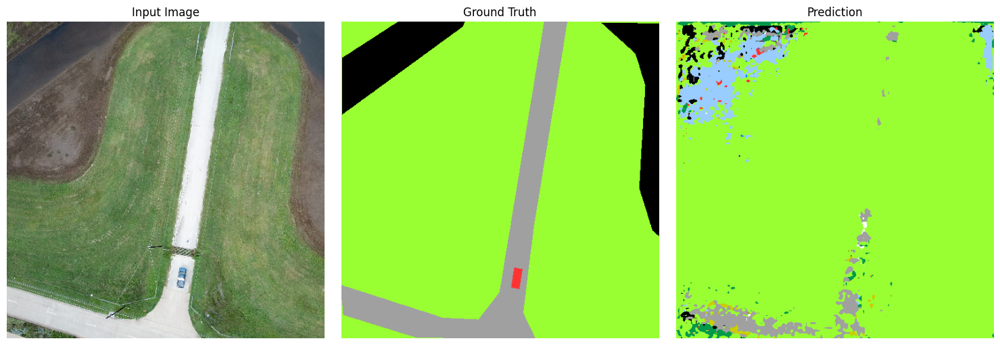

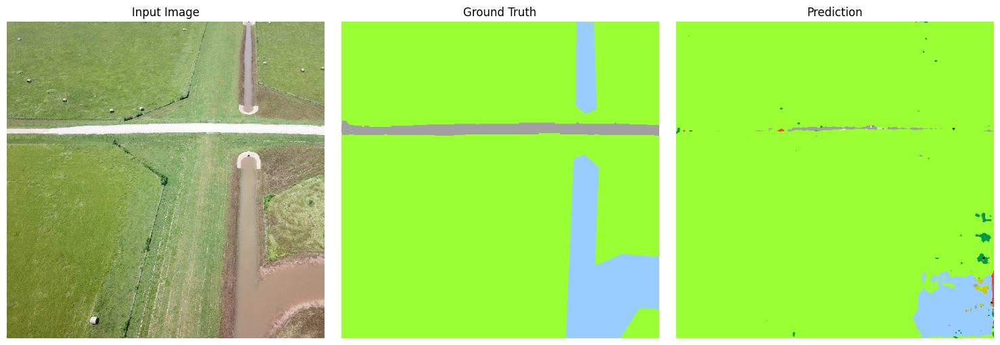

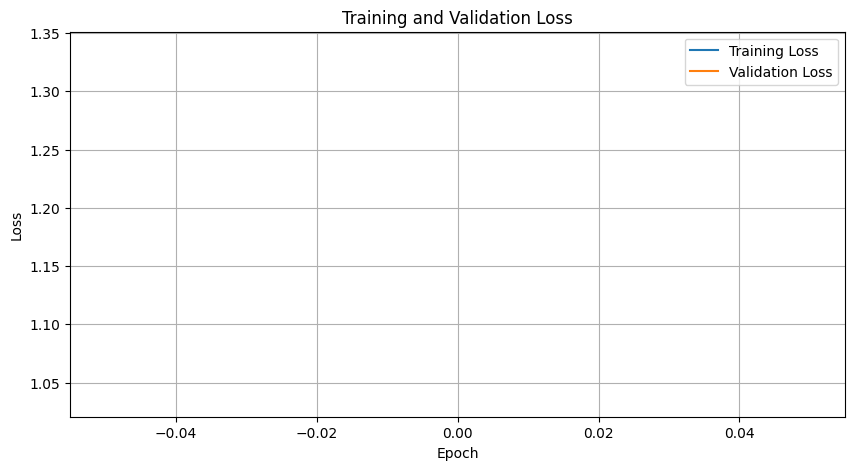

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 2/25 - 41.74s
Training Loss: 0.7399
Validation Loss: 0.5544
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 3/25 - 41.62s
Training Loss: 0.5144
Validation Loss: 0.3596
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 4/25 - 41.16s
Training Loss: 0.4135
Validation Loss: 0.2931
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 5/25 - 40.85s
Training Loss: 0.3548
Validation Loss: 0.2412
Saved best model checkpoint
Visualizing predictions after Epoch 5


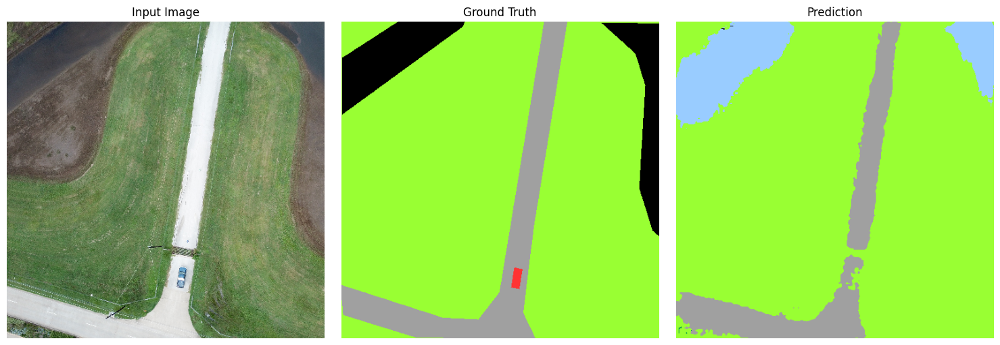

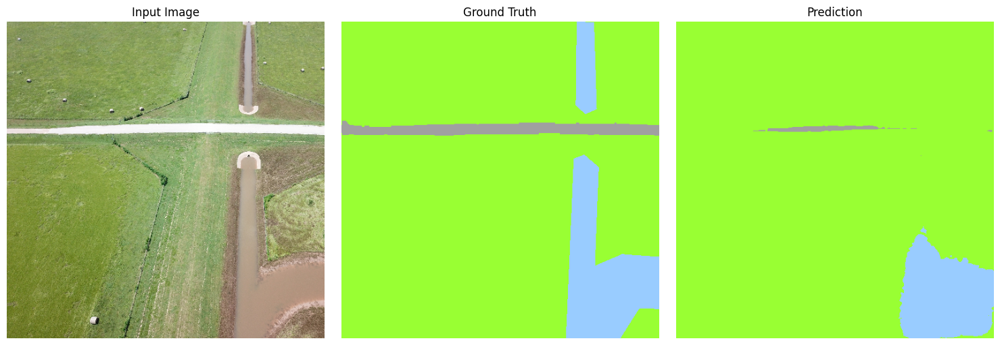

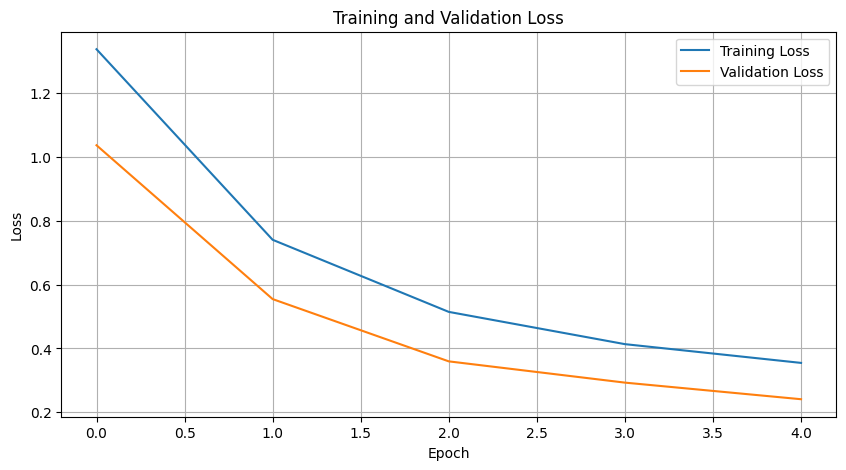

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 6/25 - 40.84s
Training Loss: 0.3168
Validation Loss: 0.2195
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 7/25 - 41.02s
Training Loss: 0.2951
Validation Loss: 0.2017
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 8/25 - 40.45s
Training Loss: 0.2791
Validation Loss: 0.1967
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 9/25 - 40.57s
Training Loss: 0.2553
Validation Loss: 0.1943
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 10/25 - 41.11s
Training Loss: 0.2586
Validation Loss: 0.2034
Visualizing predictions after Epoch 10


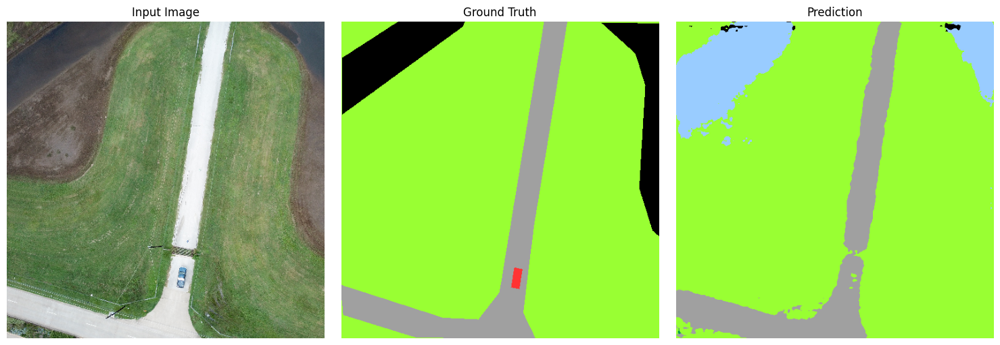

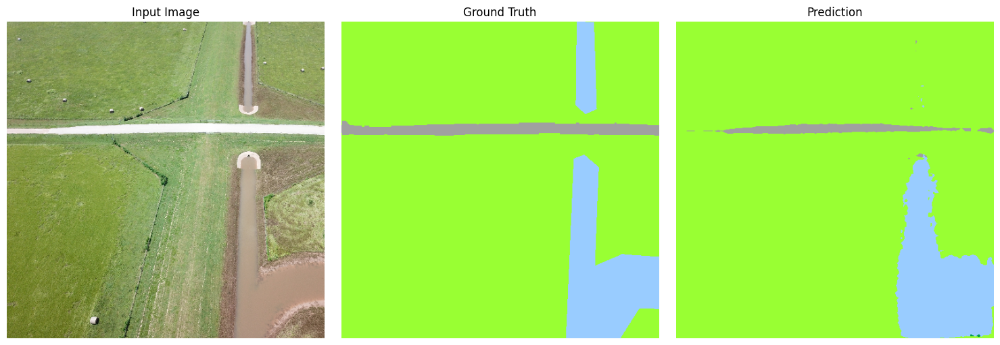

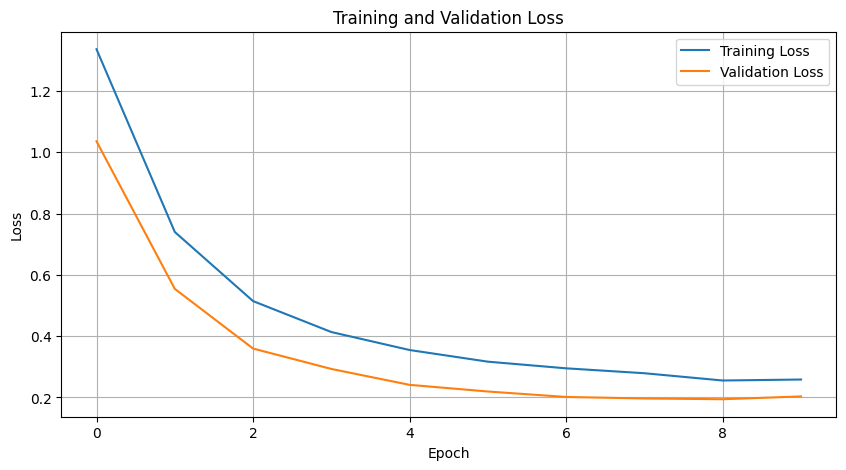

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 11/25 - 41.78s
Training Loss: 0.2343
Validation Loss: 0.1740
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 12/25 - 40.83s
Training Loss: 0.2313
Validation Loss: 0.1686
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 13/25 - 40.84s
Training Loss: 0.2163
Validation Loss: 0.1708


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 14/25 - 41.34s
Training Loss: 0.2090
Validation Loss: 0.1822


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 15/25 - 41.92s
Training Loss: 0.2099
Validation Loss: 0.1731
Visualizing predictions after Epoch 15


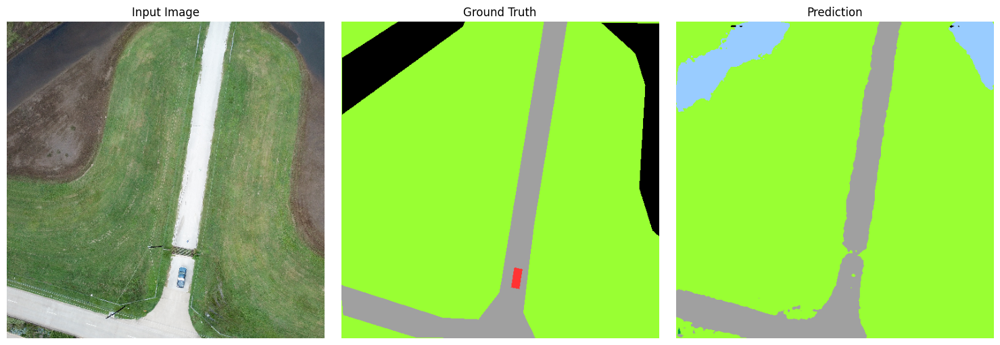

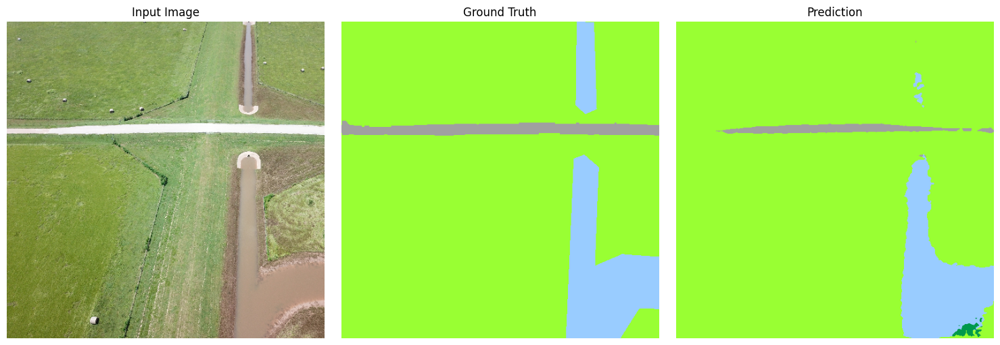

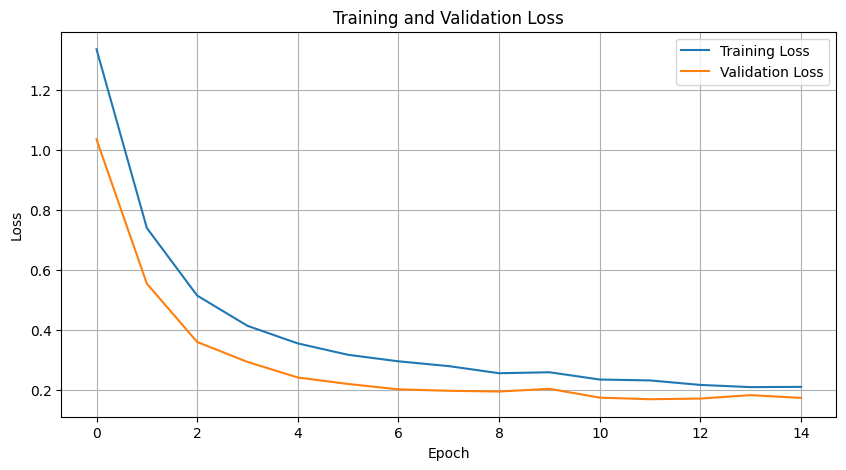

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 16/25 - 42.78s
Training Loss: 0.1954
Validation Loss: 0.1844


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 17/25 - 43.90s
Training Loss: 0.1915
Validation Loss: 0.1834


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 18/25 - 43.18s
Training Loss: 0.1910
Validation Loss: 0.1760


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 19/25 - 43.12s
Training Loss: 0.1989
Validation Loss: 0.1767


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 20/25 - 42.96s
Training Loss: 0.1970
Validation Loss: 0.1810
Visualizing predictions after Epoch 20


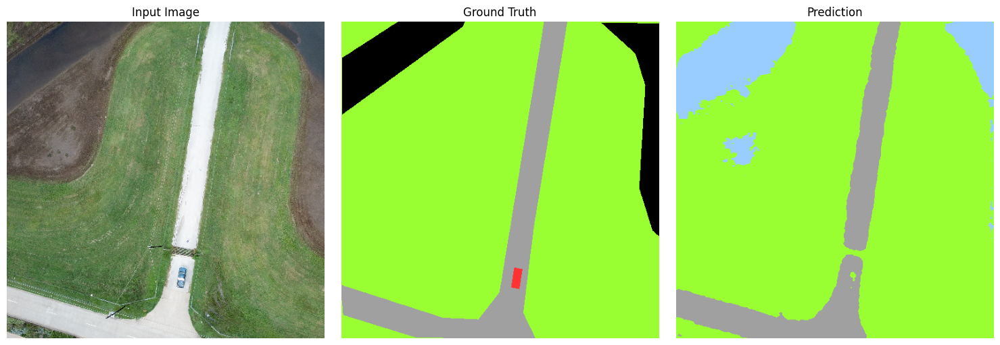

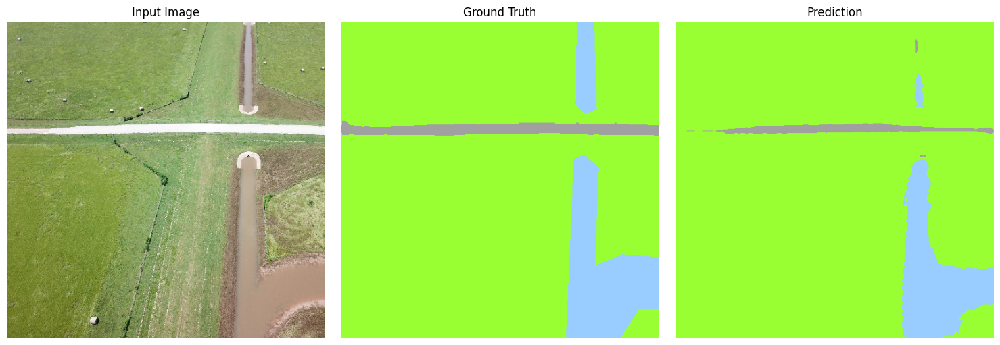

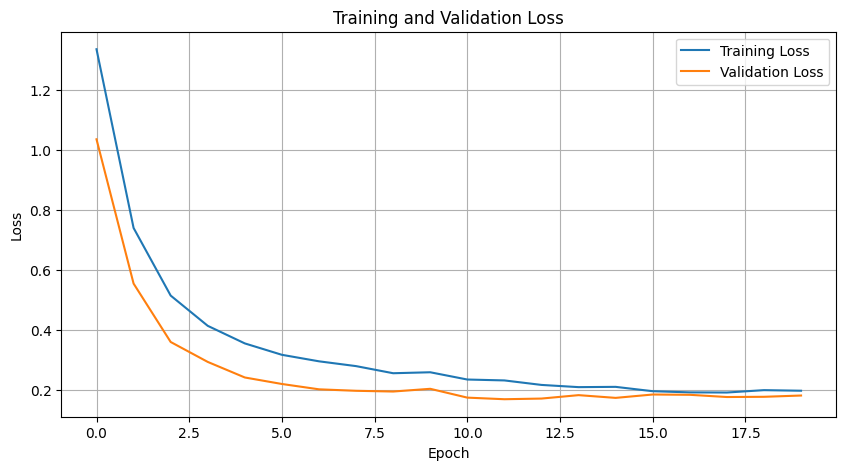

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 21/25 - 43.40s
Training Loss: 0.1855
Validation Loss: 0.1726


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 22/25 - 42.68s
Training Loss: 0.1962
Validation Loss: 0.1779


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 23/25 - 42.61s
Training Loss: 0.1845
Validation Loss: 0.1861


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 24/25 - 42.62s
Training Loss: 0.1775
Validation Loss: 0.1813


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 25/25 - 42.67s
Training Loss: 0.1723
Validation Loss: 0.1940
Visualizing predictions after Epoch 25


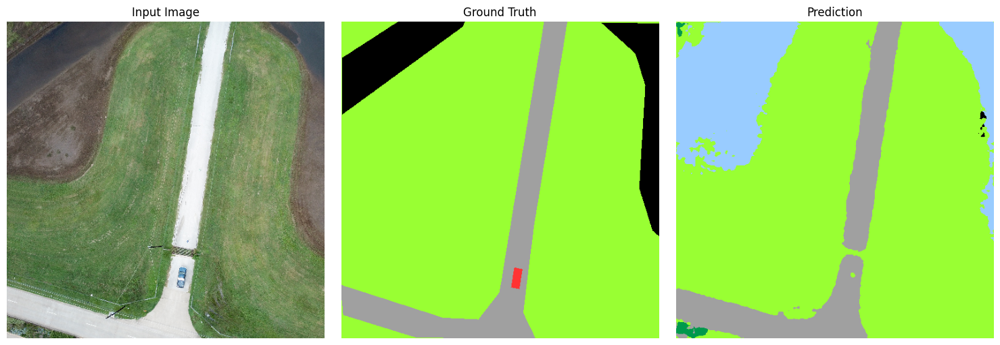

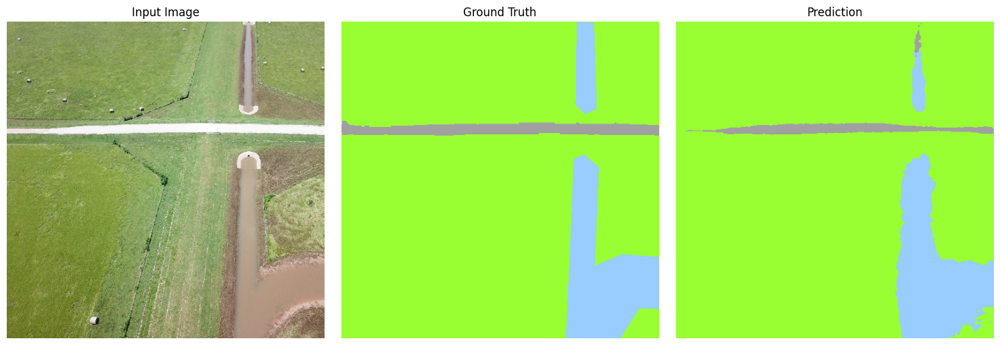

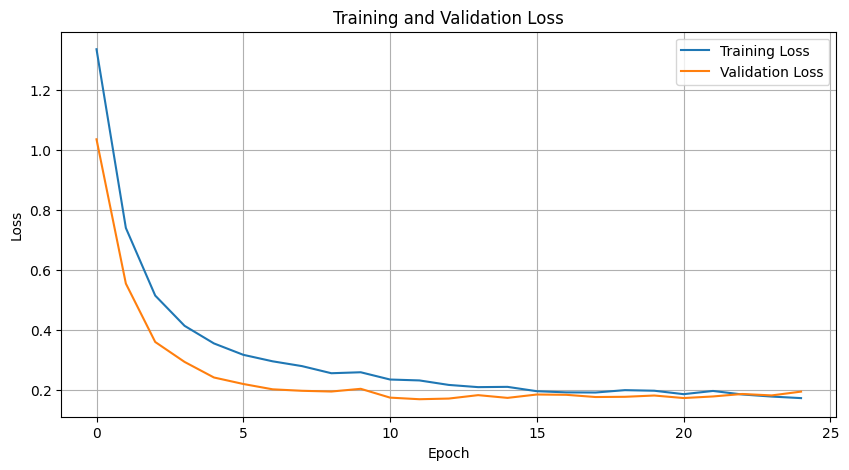

/tmp/ipykernel_151/2294960320.py:40: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('best_segmentation_model.pth'))


In [26]:
segmentation_model, seg_train_losses, seg_val_losses = train_segmentation_model(
segmentation_model, Config.NUM_EPOCHS, train_loader, val_loader, criterion, optimizer
)

In [27]:
# -------------- COMPUTE METRICS --------------

def compute_dice_scores(model, dataloader, device, num_classes):
    model.eval()
    dice_scores = np.zeros(num_classes)
    class_counts = np.zeros(num_classes)
    
    with torch.no_grad():
        for images, masks in tqdm(dataloader, desc="Computing Dice scores"):
            images, masks = images.to(device), masks.to(device)
            
            outputs = model(images)
            predictions = torch.argmax(outputs, dim=1)
            
            # Calculate Dice score for each class
            for cls in range(num_classes):
                pred_mask = (predictions == cls).cpu().numpy()
                gt_mask = (masks == cls).cpu().numpy()
                
                # Count images that have this class
                has_class = np.any(gt_mask, axis=(1, 2))
                class_counts[cls] += np.sum(has_class)
                
                # Calculate Dice for each image
                for i in range(images.size(0)):
                    if has_class[i]:
                        pred = pred_mask[i]
                        gt = gt_mask[i]
                        
                        intersection = np.logical_and(pred, gt).sum()
                        union = pred.sum() + gt.sum()
                        
                        if union > 0:
                            dice_scores[cls] += (2 * intersection / union)
    
    # Average Dice scores
    for cls in range(num_classes):
        if class_counts[cls] > 0:
            dice_scores[cls] /= class_counts[cls]
    
    # Calculate mean Dice score
    valid_classes = class_counts > 0
    mean_dice = np.mean(dice_scores[valid_classes])
    
    return mean_dice, dice_scores

In [28]:
 mean_dice, class_dice_scores = compute_dice_scores(
     segmentation_model, val_loader, Config.DEVICE, Config.NUM_CLASSES
 )
 print(f"Mean Dice Score: {mean_dice:.4f}")
 for cls in range(Config.NUM_CLASSES):
     print(f"Class {cls} Dice Score: {class_dice_scores[cls]:.4f}")

Computing Dice scores:   0%|          | 0/8 [00:00<?, ?it/s]

Mean Dice Score: 0.3995
Class 0 Dice Score: 0.0000
Class 1 Dice Score: 0.3903
Class 2 Dice Score: 0.3876
Class 3 Dice Score: 0.2302
Class 4 Dice Score: 0.7354
Class 5 Dice Score: 0.7132
Class 6 Dice Score: 0.6475
Class 7 Dice Score: 0.0000
Class 8 Dice Score: 0.0000
Class 9 Dice Score: 0.8908
Class 10 Dice Score: 0.0000


In [29]:
print("\n" + "="*50)
print("BINARY FLOOD CLASSIFICATION WITH EFFICIENTNET")
print("="*50 + "\n")


BINARY FLOOD CLASSIFICATION WITH EFFICIENTNET



In [30]:
# -------------- CLASSIFICATION DATASET --------------

class FloodClassificationDataset(Dataset):
    def __init__(self, dataframe, transform=None, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
        self.dataframe = dataframe
        self.transform = transform
        self.mean = mean
        self.std = std
    
    def __len__(self):
        return len(self.dataframe)
    
    def __getitem__(self, idx):
        row = self.dataframe.iloc[idx]
        
        # Load and preprocess image
        img = preprocess_image(row['image_path'])
        
        # Get label (is_flooded)
        label = row['is_flooded']
        
        # Apply transformations if specified
        if self.transform is not None:
            augmented = self.transform(image=img)
            img = augmented['image']
        
        # Convert to tensor and normalize
        img = Image.fromarray(img)
        t = T.Compose([T.ToTensor(), T.Normalize(self.mean, self.std)])
        img = t(img)
        
        return img, torch.tensor(label, dtype=torch.long)

In [31]:
# -------------- CLASSIFICATION CONFIG --------------

class ClassificationConfig:
    IMAGE_SIZE = (384, 384)
    BATCH_SIZE = 8
    NUM_CLASSES = 2  # Binary classification: flooded or non-flooded
    LEARNING_RATE = 1e-4
    NUM_EPOCHS = 15
    EFFICIENTNET_VERSION = 'b0'
    DEVICE = Config.DEVICE

In [32]:
# -------------- CLASSIFICATION TRANSFORMATIONS --------------

classification_train_transforms = A.Compose([
    A.Resize(ClassificationConfig.IMAGE_SIZE[0], ClassificationConfig.IMAGE_SIZE[1]),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.3),
    A.ShiftScaleRotate(p=0.3)
])

classification_val_transforms = A.Compose([
    A.Resize(ClassificationConfig.IMAGE_SIZE[0], ClassificationConfig.IMAGE_SIZE[1])
])

In [33]:
# -------------- CLASSIFICATION DATASETS & DATALOADERS --------------

class_train_dataset = FloodClassificationDataset(X_train, transform=classification_train_transforms, mean=mean, std=std)
class_val_dataset = FloodClassificationDataset(X_val, transform=classification_val_transforms, mean=mean, std=std)

class_train_loader = DataLoader(
    class_train_dataset,
    batch_size=ClassificationConfig.BATCH_SIZE,
    shuffle=True,
    num_workers=4
)

class_val_loader = DataLoader(
    class_val_dataset,
    batch_size=ClassificationConfig.BATCH_SIZE,
    shuffle=False,
    num_workers=4
)

In [34]:
# -------------- CLASSIFICATION MODEL --------------

class FloodClassifier(nn.Module):
    """Binary classifier based on EfficientNet"""
    
    def __init__(self, model_name='efficientnet-b0', num_classes=2, pretrained=True):
        super(FloodClassifier, self).__init__()
        
        # Load pre-trained EfficientNet
        self.model = EfficientNet.from_pretrained(model_name) if pretrained else EfficientNet.from_name(model_name)
        
        # Replace final fully connected layer
        feature_dims = self.model._fc.in_features
        self.model._fc = nn.Sequential(
            nn.Dropout(0.3),  # Add dropout for regularization
            nn.Linear(feature_dims, num_classes)
        )
    
    def forward(self, x):
        return self.model(x)

In [35]:
# Initialize classification model
flood_classifier = FloodClassifier(
    model_name=f'efficientnet-{ClassificationConfig.EFFICIENTNET_VERSION}',
    num_classes=ClassificationConfig.NUM_CLASSES,
    pretrained=True
)
flood_classifier = flood_classifier.to(ClassificationConfig.DEVICE)

# Define loss function and optimizer
classification_criterion = nn.CrossEntropyLoss()
classification_optimizer = torch.optim.Adam(
    flood_classifier.parameters(), 
    lr=ClassificationConfig.LEARNING_RATE
)
classification_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    classification_optimizer, 
    mode='min', 
    factor=0.5, 
    patience=3, 
    verbose=True
)

Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b0-355c32eb.pth" to /root/.cache/torch/hub/checkpoints/efficientnet-b0-355c32eb.pth
100%|██████████| 20.4M/20.4M [00:00<00:00, 167MB/s]

Loaded pretrained weights for efficientnet-b0



/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


In [36]:
# -------------- CLASSIFICATION TRAINING FUNCTIONS --------------

def train_classification_epoch(model, loader, criterion, optimizer, device):
    """Train the classification model for one epoch"""
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0
    
    for images, labels in tqdm(loader, desc="Training"):
        images, labels = images.to(device), labels.to(device)
        
        # Forward pass
        outputs = model(images)
        loss = criterion(outputs, labels)
        
        # Backward pass and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        # Track statistics
        running_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
    
    epoch_loss = running_loss / len(loader)
    epoch_acc = 100.0 * correct / total
    
    return epoch_loss, epoch_acc

def evaluate_classification(model, loader, criterion, device):
    """Evaluate the classification model"""
    model.eval()
    running_loss = 0.0
    correct = 0
    total = 0
    
    with torch.no_grad():
        for images, labels in tqdm(loader, desc="Evaluating"):
            images, labels = images.to(device), labels.to(device)
            
            # Forward pass
            outputs = model(images)
            loss = criterion(outputs, labels)
            
            # Track statistics
            running_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    
    epoch_loss = running_loss / len(loader)
    epoch_acc = 100.0 * correct / total
    
    return epoch_loss, epoch_acc

def visualize_classification_predictions(model, loader, device, num_samples=6):
    """Visualize model predictions"""
    model.eval()
    all_images = []
    all_labels = []
    all_preds = []
    
    with torch.no_grad():
        for images, labels in loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, preds = torch.max(outputs, 1)
            
            # Add to lists
            all_images.extend(images.cpu())
            all_labels.extend(labels.cpu())
            all_preds.extend(preds.cpu())
            
            if len(all_images) >= num_samples:
                break
    
    # Create figure
    fig, axes = plt.subplots(2, 3, figsize=(15, 10))
    axes = axes.flatten()
    
    for i in range(min(num_samples, len(all_images))):
        # Convert tensor to image
        img = all_images[i].permute(1, 2, 0).numpy()
        # Denormalize
        img = img * np.array(std) + np.array(mean)
        img = np.clip(img, 0, 1)
        
        # Get prediction and label
        pred = "Flooded" if all_preds[i] == 1 else "Non-Flooded"
        label = "Flooded" if all_labels[i] == 1 else "Non-Flooded"
        title = f"Pred: {pred}\nTrue: {label}"
        color = "green" if all_preds[i] == all_labels[i] else "red"
        
        # Display
        axes[i].imshow(img)
        axes[i].set_title(title, color=color)
        axes[i].axis('off')
    
    plt.tight_layout()
    plt.show()

def plot_classification_metrics(train_losses, val_losses, train_accs, val_accs):
    """Plot training and validation metrics"""
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    
    # Plot loss
    ax1.plot(train_losses, label='Training Loss')
    ax1.plot(val_losses, label='Validation Loss')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss')
    ax1.set_title('Training and Validation Loss')
    ax1.legend()
    ax1.grid(True)
    
    # Plot accuracy
    ax2.plot(train_accs, label='Training Accuracy')
    ax2.plot(val_accs, label='Validation Accuracy')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Accuracy (%)')
    ax2.set_title('Training and Validation Accuracy')
    ax2.legend()
    ax2.grid(True)
    
    plt.tight_layout()
    plt.show()

In [37]:
# -------------- TRAIN CLASSIFICATION MODEL --------------

def train_classification_model(model, num_epochs, train_loader, val_loader, criterion, optimizer, scheduler):
    train_losses = []
    val_losses = []
    train_accs = []
    val_accs = []
    best_val_acc = 0.0
    
    for epoch in range(num_epochs):
        start_time = time.time()
        
        # Train for one epoch
        train_loss, train_acc = train_classification_epoch(
            model, train_loader, criterion, optimizer, ClassificationConfig.DEVICE
        )
        
        # Evaluate
        val_loss, val_acc = evaluate_classification(
            model, val_loader, criterion, ClassificationConfig.DEVICE
        )
        
        # Update learning rate
        scheduler.step(val_loss)
        
        # Record metrics
        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        
        # Print epoch results
        epoch_time = time.time() - start_time
        print(f"Epoch {epoch+1}/{num_epochs} - {epoch_time:.2f}s")
        print(f"Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.2f}%")
        print(f"Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.2f}%")
        
        # Save best model
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            torch.save(model.state_dict(), 'best_flood_classifier.pth')
            print(f"New best model saved with validation accuracy: {val_acc:.2f}%")
        
        # Visualize predictions every 5 epochs
        if (epoch + 1) % 5 == 0 or epoch == 0:
            visualize_classification_predictions(
                model, val_loader, ClassificationConfig.DEVICE
            )
            plot_classification_metrics(
                train_losses, val_losses, train_accs, val_accs
            )
    
    # Load best model
    model.load_state_dict(torch.load('best_flood_classifier.pth'))
    return model, train_losses, val_losses, train_accs, val_accs

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 1/15 - 29.62s
Train Loss: 0.4379, Train Acc: 88.76%
Val Loss: 0.4190, Val Acc: 86.67%
New best model saved with validation accuracy: 86.67%


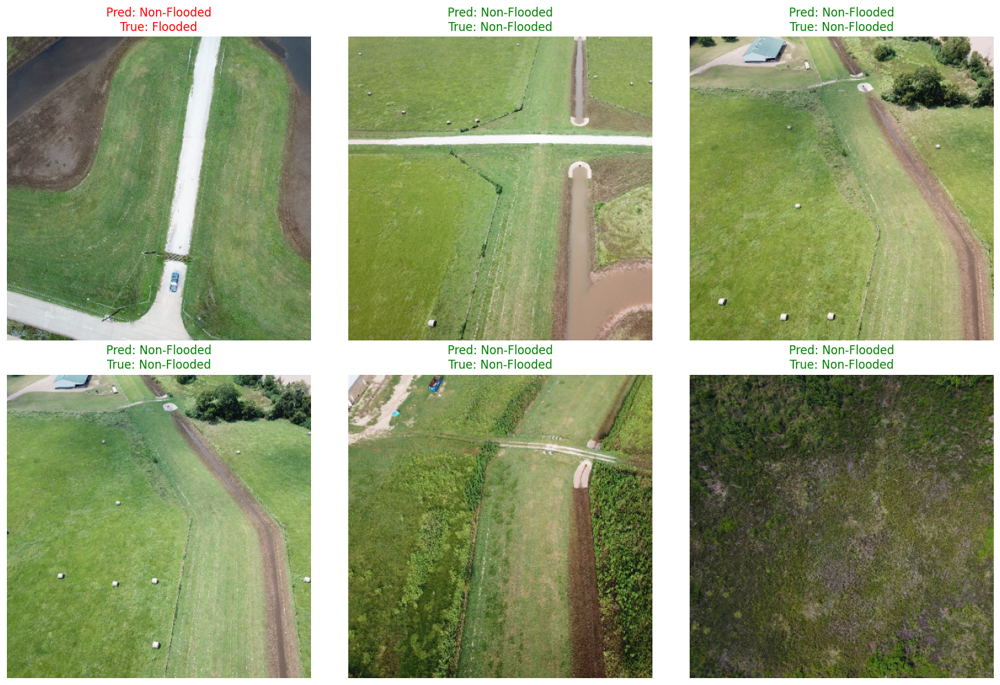

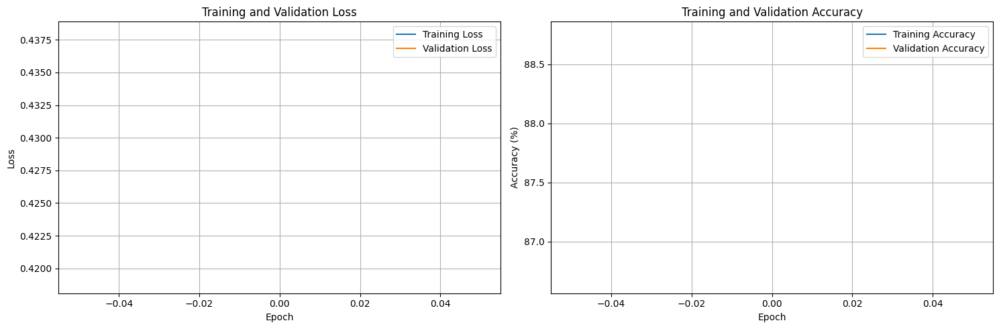

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 2/15 - 29.91s
Train Loss: 0.1998, Train Acc: 95.86%
Val Loss: 0.3278, Val Acc: 88.33%
New best model saved with validation accuracy: 88.33%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 3/15 - 29.50s
Train Loss: 0.1487, Train Acc: 95.86%
Val Loss: 0.2461, Val Acc: 93.33%
New best model saved with validation accuracy: 93.33%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 4/15 - 29.62s
Train Loss: 0.1112, Train Acc: 98.22%
Val Loss: 0.2327, Val Acc: 93.33%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 5/15 - 29.25s
Train Loss: 0.0863, Train Acc: 97.63%
Val Loss: 0.2113, Val Acc: 95.00%
New best model saved with validation accuracy: 95.00%


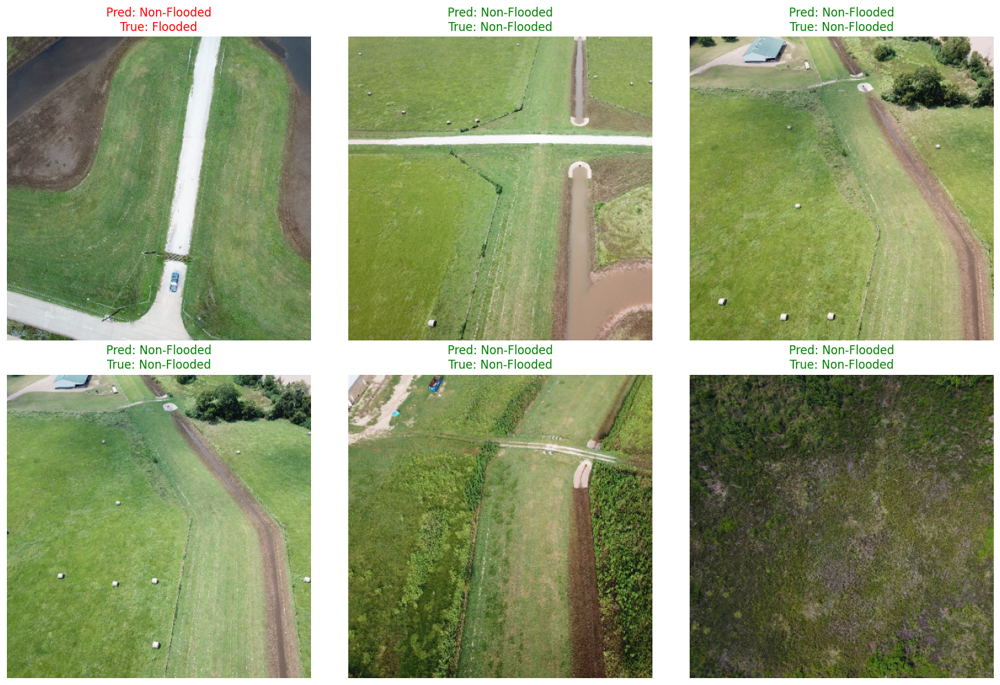

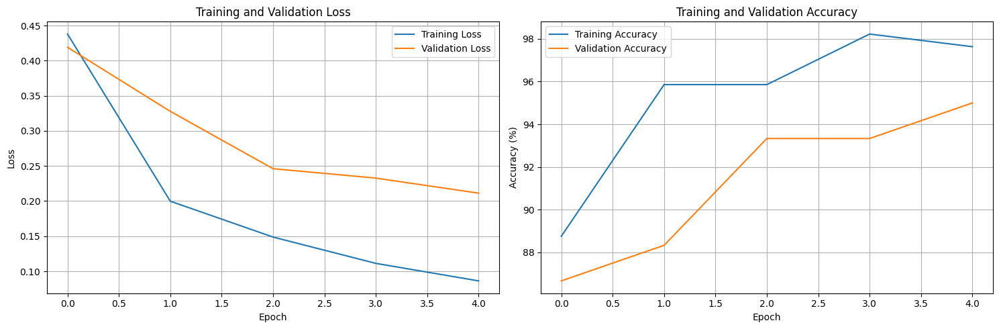

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 6/15 - 29.36s
Train Loss: 0.0612, Train Acc: 98.82%
Val Loss: 0.2080, Val Acc: 95.00%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 7/15 - 29.20s
Train Loss: 0.0558, Train Acc: 98.52%
Val Loss: 0.2110, Val Acc: 96.67%
New best model saved with validation accuracy: 96.67%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 8/15 - 28.91s
Train Loss: 0.0705, Train Acc: 97.93%
Val Loss: 0.2110, Val Acc: 96.67%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 9/15 - 29.73s
Train Loss: 0.0242, Train Acc: 100.00%
Val Loss: 0.1837, Val Acc: 96.67%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 10/15 - 29.93s
Train Loss: 0.0358, Train Acc: 99.41%
Val Loss: 0.1537, Val Acc: 96.67%


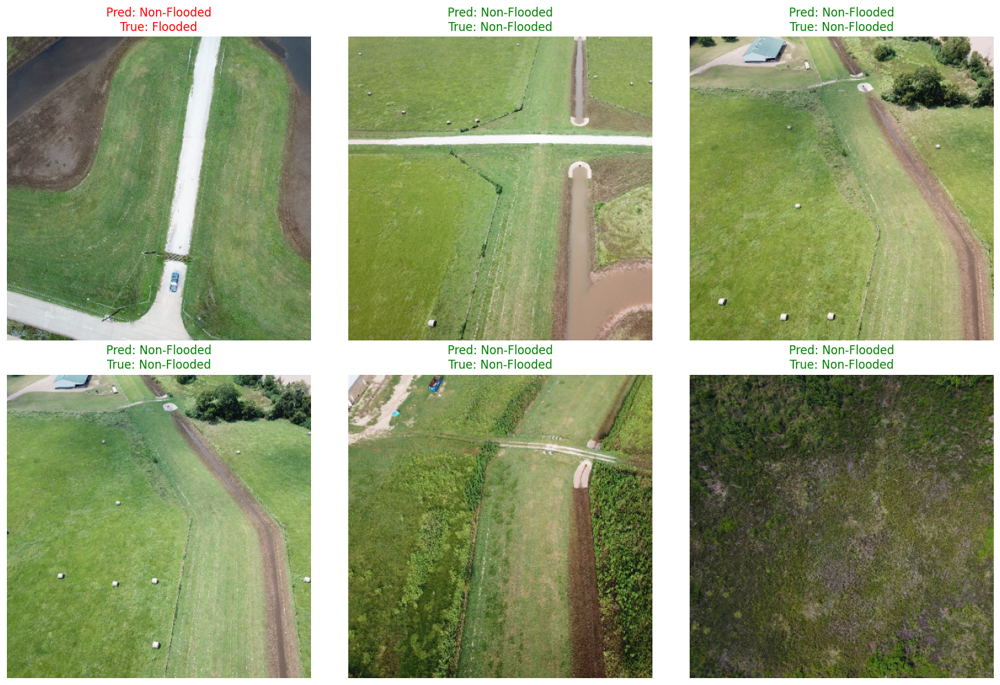

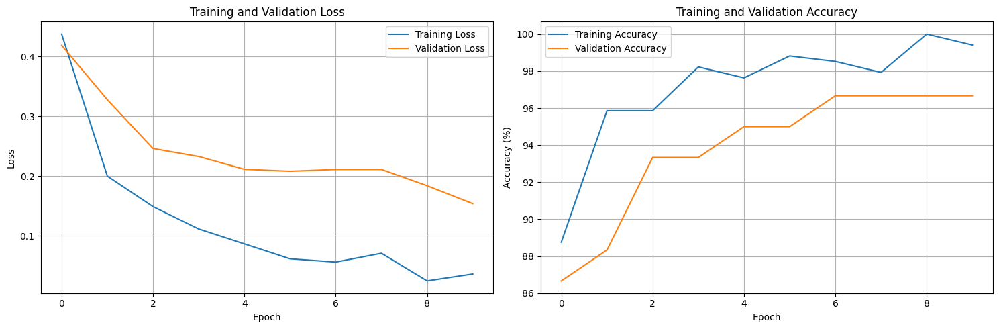

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 11/15 - 29.33s
Train Loss: 0.0348, Train Acc: 99.41%
Val Loss: 0.1497, Val Acc: 96.67%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 12/15 - 28.97s
Train Loss: 0.0538, Train Acc: 98.82%
Val Loss: 0.1806, Val Acc: 96.67%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 13/15 - 28.82s
Train Loss: 0.0434, Train Acc: 99.11%
Val Loss: 0.1974, Val Acc: 96.67%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 14/15 - 29.03s
Train Loss: 0.0229, Train Acc: 99.70%
Val Loss: 0.1711, Val Acc: 96.67%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 15/15 - 29.24s
Train Loss: 0.0187, Train Acc: 99.70%
Val Loss: 0.1501, Val Acc: 96.67%


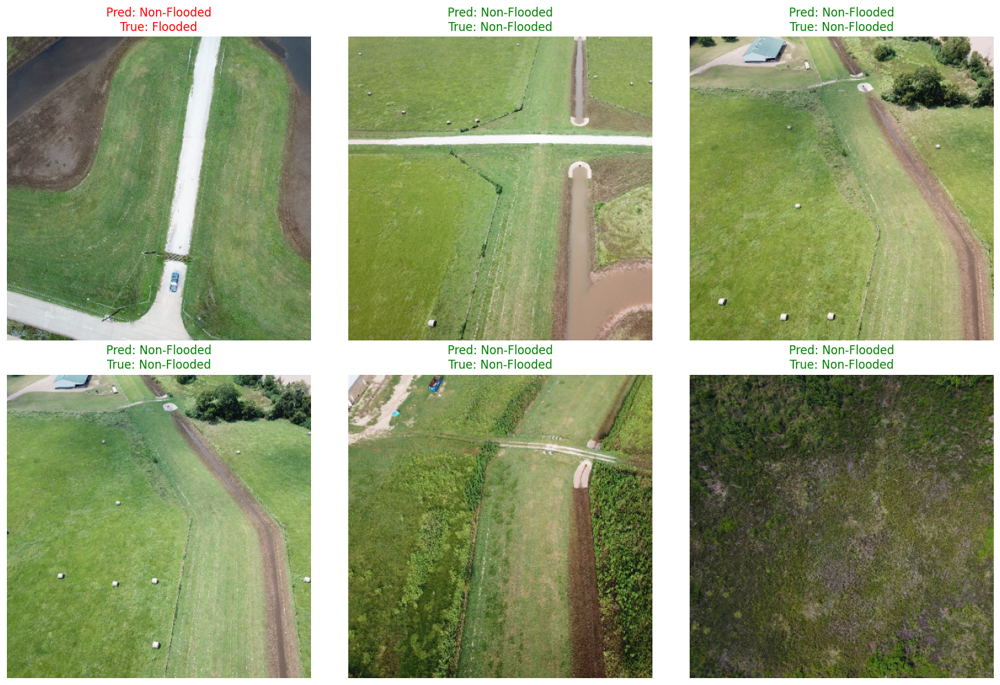

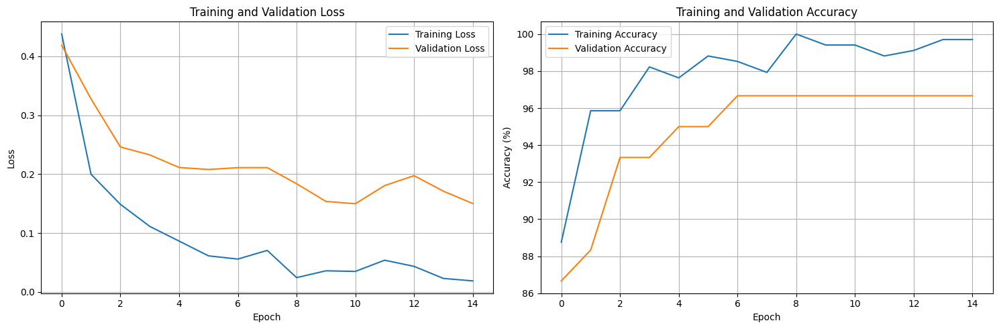

/tmp/ipykernel_151/2435253641.py:54: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('best_flood_classifier.pth'))


In [38]:
 flood_classifier, class_train_losses, class_val_losses, class_train_accs, class_val_accs = train_classification_model(
     flood_classifier, 
     ClassificationConfig.NUM_EPOCHS, 
     class_train_loader, 
     class_val_loader, 
     classification_criterion, 
     classification_optimizer,
     classification_scheduler
 )

In [41]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

def generate_classification_metrics(model, loader, device):
    """Generate classification metrics"""
    model.eval()
    all_preds = []
    all_labels = []
    
    with torch.no_grad():
        for images, labels in tqdm(loader, desc="Generating metrics"):
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, preds = torch.max(outputs, 1)
            
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    # Calculate metrics
    cm = confusion_matrix(all_labels, all_preds)
    report = classification_report(all_labels, all_preds, target_names=["Non-Flooded", "Flooded"])
    accuracy = accuracy_score(all_labels, all_preds)
    
    return cm, report, accuracy

def plot_confusion_matrix(cm, class_names):
    """Plot the confusion matrix using Seaborn heatmap"""
    plt.figure(figsize=(6, 5))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.tight_layout()
    plt.show()




Generating metrics:   0%|          | 0/8 [00:00<?, ?it/s]

Accuracy: 96.67%

Classification Report:
               precision    recall  f1-score   support

 Non-Flooded       0.96      1.00      0.98        52
     Flooded       1.00      0.75      0.86         8

    accuracy                           0.97        60
   macro avg       0.98      0.88      0.92        60
weighted avg       0.97      0.97      0.96        60



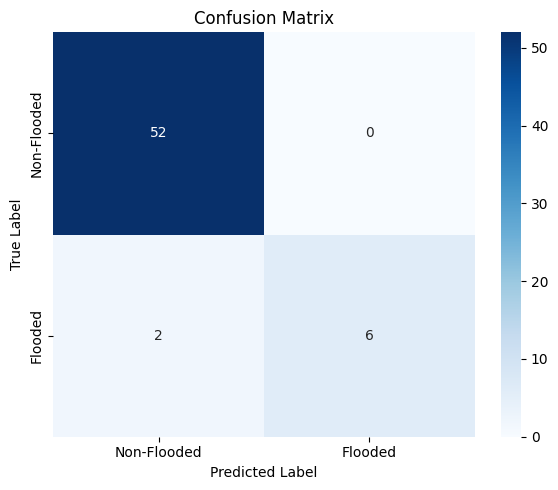

In [42]:
cm, report, accuracy = generate_classification_metrics(flood_classifier, class_val_loader, ClassificationConfig.DEVICE)
print(f"Accuracy: {accuracy*100:.2f}%")
print("\nClassification Report:\n", report)
plot_confusion_matrix(cm, ["Non-Flooded", "Flooded"])